## Name: Shobhit Verma

In [1]:
import numpy as np
import pandas as pd
import json
import re
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
with open('C:/Users/Shobhit Verma/Downloads/new_measurements.json', 'r') as file:
    raw_data = json.load(file)
data = raw_data['data']

In [3]:
# Extract columns tid, timestamps and values for all timestamps
df = {'tid': [], 'timestamps': [], 'sensor_values': []}

for timestep in data:
    for index, value in enumerate(timestep['timestamps']):
        df['tid'].append(timestep['tid'])
        df['timestamps'].append(value)
        df['sensor_values'].append(timestep['values'][index])
df

{'tid': ['voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  'voltage_sensor_0',
  '

In [4]:
dataframe = pd.DataFrame(df)
dataframe.tail()

,tid,timestamps,sensor_values
599995,voltage_sensor_19,2022-05-07 08:08:34.749560,25
599996,voltage_sensor_19,2022-05-07 08:08:37.749560,23.3
599997,voltage_sensor_19,2022-05-07 08:08:39.749560,22
599998,voltage_sensor_19,2022-05-07 08:08:40.749560,26
599999,voltage_sensor_19,2022-05-07 08:08:43.749560,28


In [5]:
dataframe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 600000 entries, 0 to 599999
Data columns (total 3 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   tid            600000 non-null  object
 1   timestamps     600000 non-null  object
 2   sensor_values  600000 non-null  object
dtypes: object(3)
memory usage: 13.7+ MB


In [6]:
# Remove the millisecond precision values in timestamps
dataframe['timestamps'] = dataframe['timestamps'].apply(lambda x: re.sub(r'\..*', '', x))

In [7]:
# Convert timestamp readings to float values for analysis
dataframe['sensor_values'] = pd.to_numeric(dataframe['sensor_values'],errors='coerce')
dataframe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 600000 entries, 0 to 599999
Data columns (total 3 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   tid            600000 non-null  object 
 1   timestamps     600000 non-null  object 
 2   sensor_values  560359 non-null  float64
dtypes: float64(1), object(2)
memory usage: 13.7+ MB


In [8]:
# Convert timestamp column values to datetime for analysis
dataframe['timestamps'] = pd.to_datetime(dataframe['timestamps'])
dataframe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 600000 entries, 0 to 599999
Data columns (total 3 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   tid            600000 non-null  object        
 1   timestamps     600000 non-null  datetime64[ns]
 2   sensor_values  560359 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(1)
memory usage: 13.7+ MB


In [9]:
dataframe.head()

,tid,timestamps,sensor_values
0,voltage_sensor_0,2022-05-06 11:19:22,23.0
1,voltage_sensor_0,2022-05-06 11:19:25,26.0
2,voltage_sensor_0,2022-05-06 11:19:29,25.8
3,voltage_sensor_0,2022-05-06 11:19:30,27.3
4,voltage_sensor_0,2022-05-06 11:19:32,22.7


## Exploratory Data Analysis

In [14]:
# adding separate time and date columns
dataframe["DATE"] = pd.to_datetime(dataframe["timestamps"]).dt.date
dataframe["TIME"] = pd.to_datetime(dataframe["timestamps"]).dt.time
dataframe['DAY'] = pd.to_datetime(dataframe['timestamps']).dt.day
dataframe['MONTH'] = pd.to_datetime(dataframe['timestamps']).dt.month
dataframe['WEEK'] = pd.to_datetime(dataframe['timestamps']).dt.week


# add hours and minutes for ml models
dataframe['HOURS'] = pd.to_datetime(dataframe['TIME'],format='%H:%M:%S').dt.hour
dataframe['MINUTES'] = pd.to_datetime(dataframe['TIME'],format='%H:%M:%S').dt.minute
dataframe['TOTAL MINUTES PASS'] = dataframe['MINUTES'] + dataframe['HOURS']*60

# add date as string column
dataframe["DATE_STRING"] = dataframe["DATE"].astype(str) # add column with date as string
dataframe["HOURS"] = dataframe["HOURS"].astype(str)
dataframe["TIME"] = dataframe["TIME"].astype(str)

dataframe.head(2)



C:\Users\Shobhit Verma\AppData\Local\Temp\ipykernel_15664\1773333779.py:6: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  dataframe['WEEK'] = pd.to_datetime(dataframe['timestamps']).dt.week


,tid,timestamps,sensor_values,DATE,TIME,DAY,MONTH,WEEK,HOURS,MINUTES,TOTAL MINUTES PASS,DATE_STRING
0,voltage_sensor_0,2022-05-06 11:19:22,23.0,2022-05-06,11:19:22,6,5,18,11,19,679,2022-05-06
1,voltage_sensor_0,2022-05-06 11:19:25,26.0,2022-05-06,11:19:25,6,5,18,11,19,679,2022-05-06


In [16]:
# for index in range(20):
#     iterator = 'voltage_sensor_' + str(index)
#     sensor_data = dataframe.loc[dataframe['tid'] == iterator]
#     plt.plot(sensor_data['timestamps'], sensor_data['values'])
#     plt.show()

sensor_data = dataframe.loc[dataframe['tid'] == 'voltage_sensor_19']
sensor_data = sensor_data.dropna()

In [17]:
sensor_data.isna().sum()

tid                   0
timestamps            0
sensor_values         0
DATE                  0
TIME                  0
DAY                   0
MONTH                 0
WEEK                  0
HOURS                 0
MINUTES               0
TOTAL MINUTES PASS    0
DATE_STRING           0
dtype: int64

## Q.1 How many Empty values were removed?

In [18]:
# Create a copy of the dataframe
df_copy = dataframe.copy(deep = True)

In [19]:
null_count = dataframe.isna().sum()
dataframe = dataframe.dropna()
null_count

tid                       0
timestamps                0
sensor_values         39641
DATE                      0
TIME                      0
DAY                       0
MONTH                     0
WEEK                      0
HOURS                     0
MINUTES                   0
TOTAL MINUTES PASS        0
DATE_STRING               0
dtype: int64

### 39641 empty values were removed from the dataset

## Q.2 How many outliers were removed?

I use the Modified Z-Score method to detect and remove outliers. Description of the method can be found on this link: https://www.kaggle.com/discussions/general/382825

In [20]:
from scipy import stats

In [21]:
len(dataframe)

560359

In [22]:
outlier_count = 0
# Set threshold for outliers
threshold = 3.5

for index in range(20):
    iterator = 'voltage_sensor_' + str(index)
    
    df = dataframe[dataframe['tid'] == iterator]
    
    # Calculate Modified Z-score
    median = df['sensor_values'].median()
    mad = np.median(np.abs(df['sensor_values'] - median))
    df['Modified Z-score'] = 0.6745 * (df['sensor_values'] - median) / mad
    outliers = df[(np.abs(df['Modified Z-score']) > threshold)]
    outlier_count += len(outliers)
    

print(outlier_count)

C:\Users\Shobhit Verma\AppData\Local\Temp\ipykernel_15664\1010215478.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Modified Z-score'] = 0.6745 * (df['sensor_values'] - median) / mad
C:\Users\Shobhit Verma\AppData\Local\Temp\ipykernel_15664\1010215478.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Modified Z-score'] = 0.6745 * (df['sensor_values'] - median) / mad
C:\Users\Shobhit Verma\AppData\Local\Temp\ipykernel_15664\1010215478.py:13: SettingWithCopyWarning: 
A value is trying to be s

55963


C:\Users\Shobhit Verma\AppData\Local\Temp\ipykernel_15664\1010215478.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Modified Z-score'] = 0.6745 * (df['sensor_values'] - median) / mad
C:\Users\Shobhit Verma\AppData\Local\Temp\ipykernel_15664\1010215478.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Modified Z-score'] = 0.6745 * (df['sensor_values'] - median) / mad


### 55963 outlier values were detected based on the Modified Z-Score across all sensors 

## Q.3 What trends did you observe (e.g. minutely/hourly/daily) in each

Text(0, 0.5, 'Sensor Values')

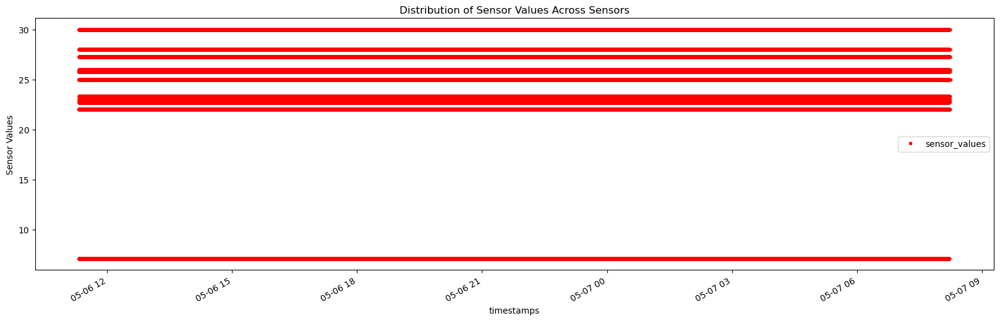

In [50]:
dataframe.plot(x= 'timestamps', y='sensor_values', style='.', figsize = (20, 6),color= "red");
plt.title('Distribution of Sensor Values Across Sensors')
plt.ylabel('Sensor Values')

The bands indicate that as a whole, sensor values are clustered at certain, discrete values. An interesting observation is the huge gap observed between the first and second lowest bands - indicating that voltage jumps sharply between the minimum value and the rest of the values.

#### Time Series Plots for All Sensors (Hourly Basis)

Since each sensor has 30,000 data points, the line graph depicting values for the time period starting from 06th May 2022 11:19:21 AM to 07th May 2022 08:08:43 AM does not yield any useful information. Hence, data points are analysed on an hourly basis to gain insights.

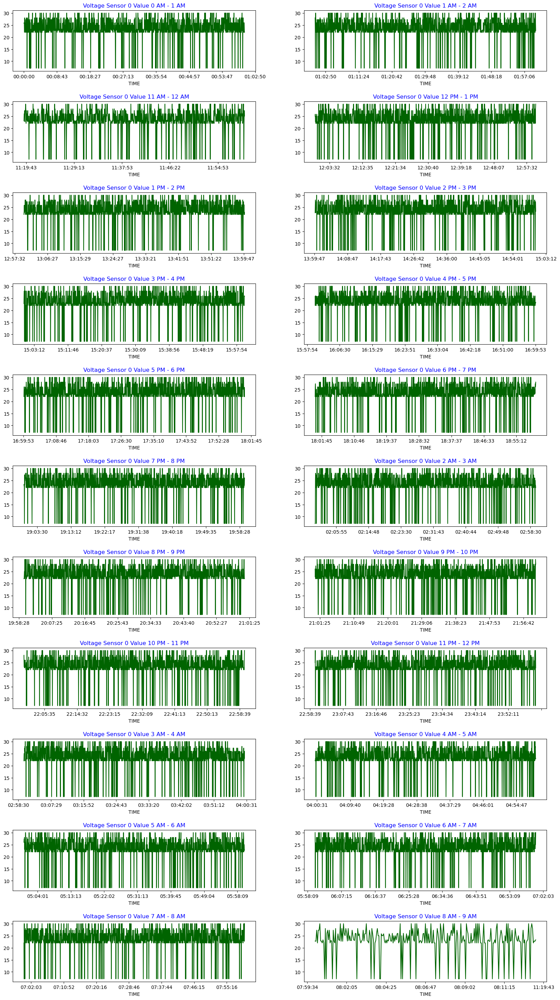

In [23]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_0']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 0 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


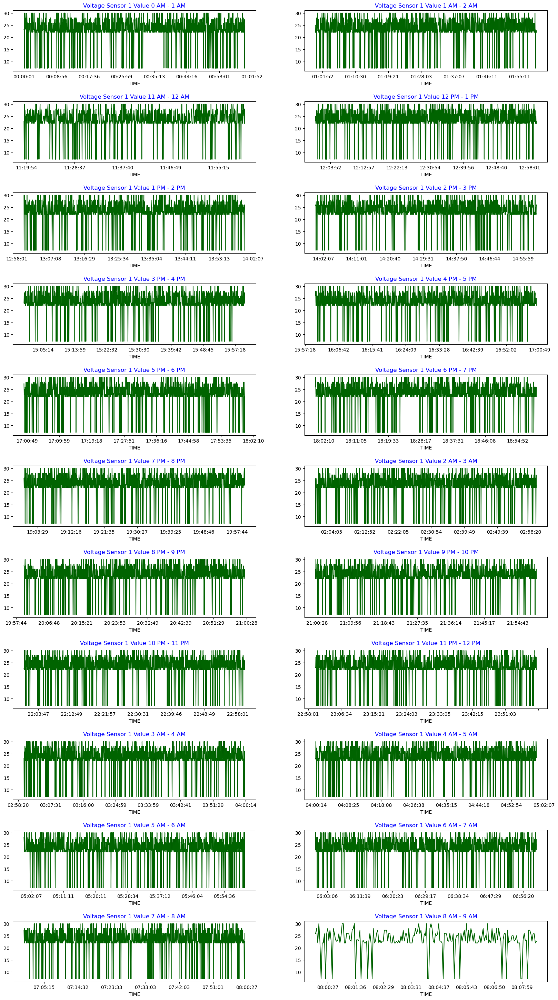

In [24]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_1']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 1 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


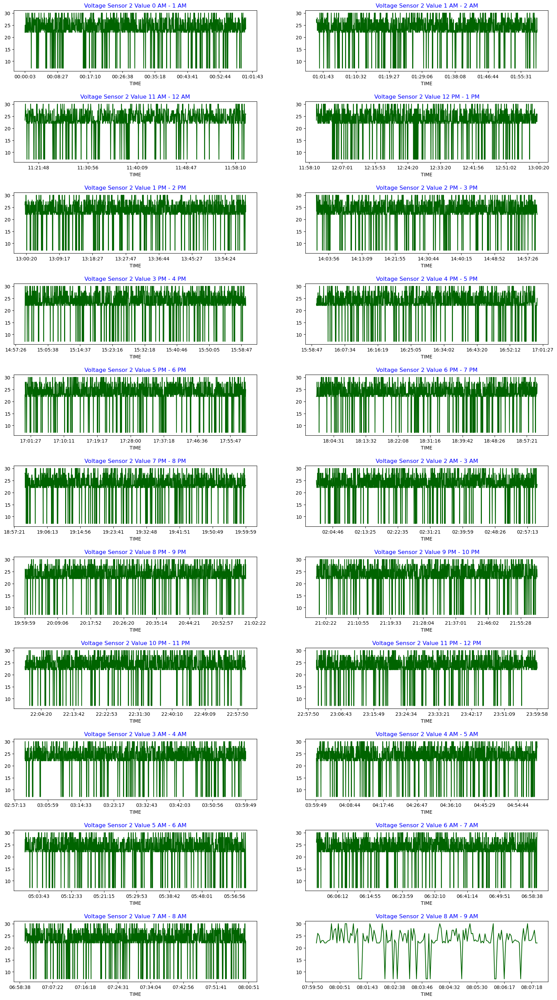

In [25]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_2']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 2 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


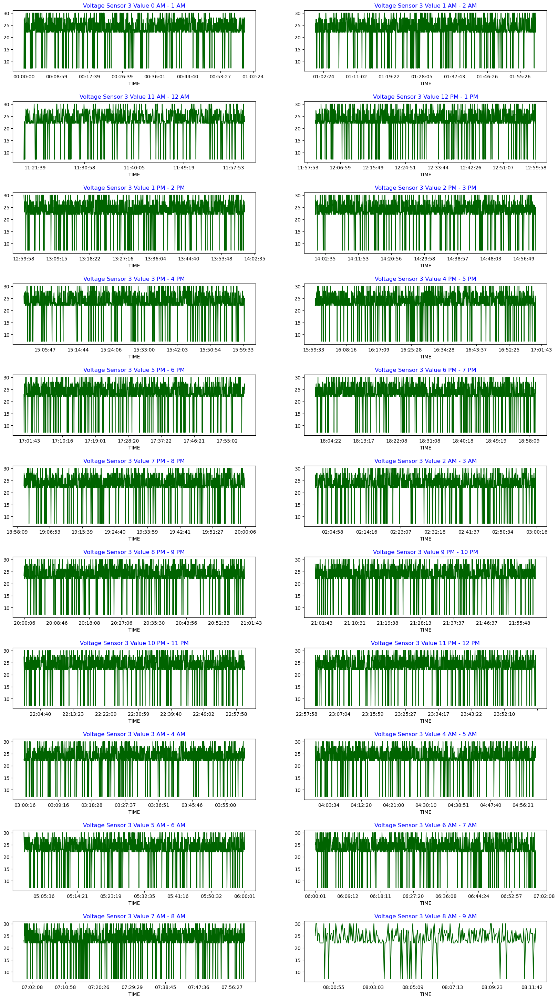

In [26]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_3']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 3 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


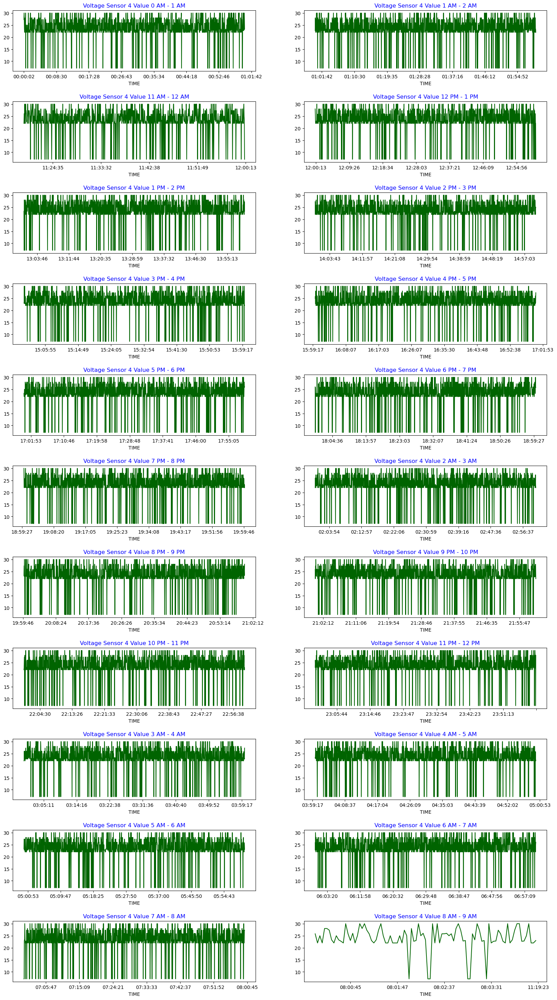

In [27]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_4']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 4 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


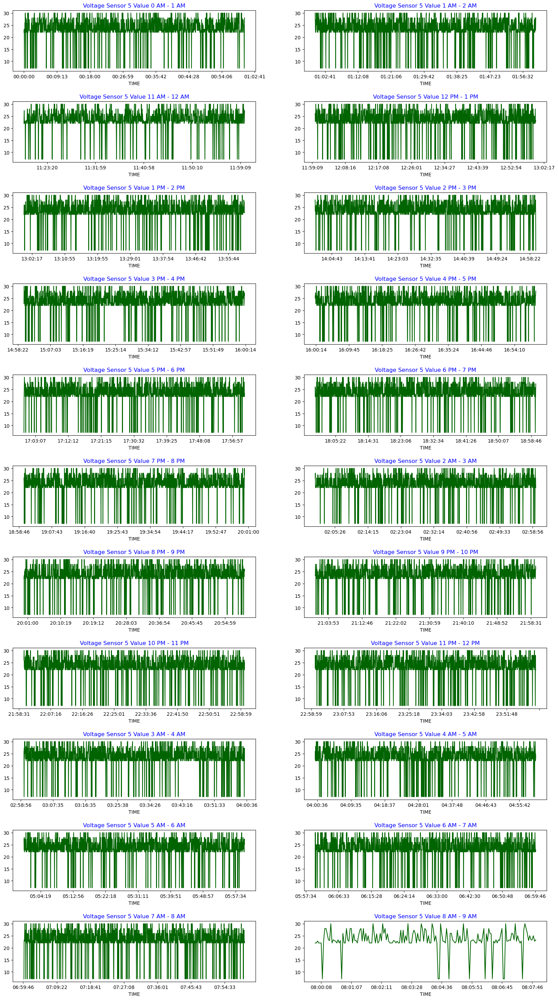

In [28]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_5']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 5 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


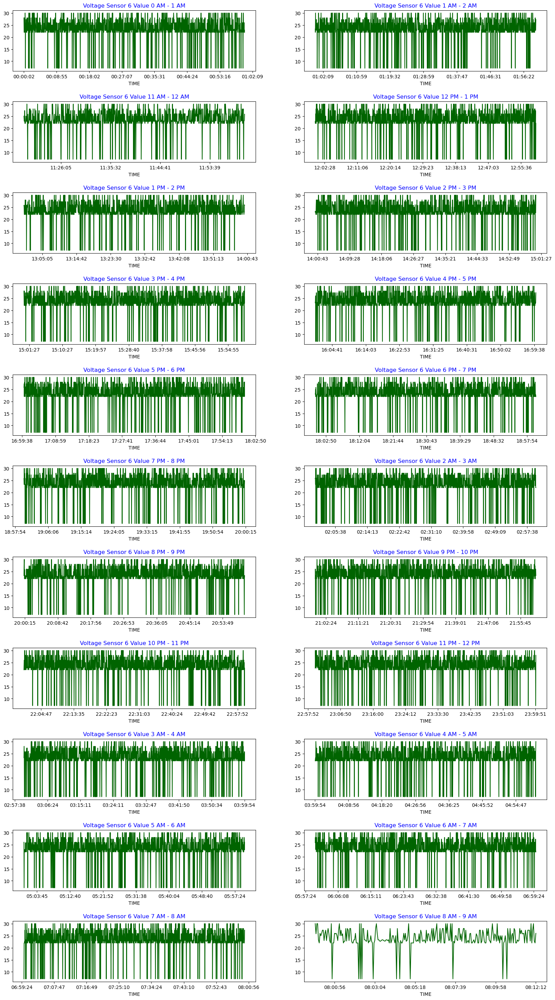

In [29]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_6']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 6 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


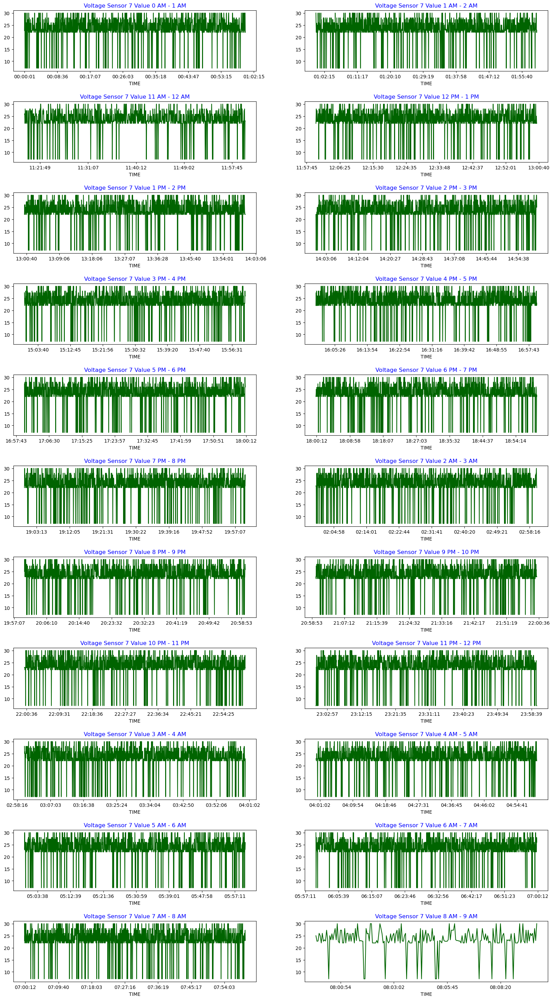

In [30]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_7']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 7 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


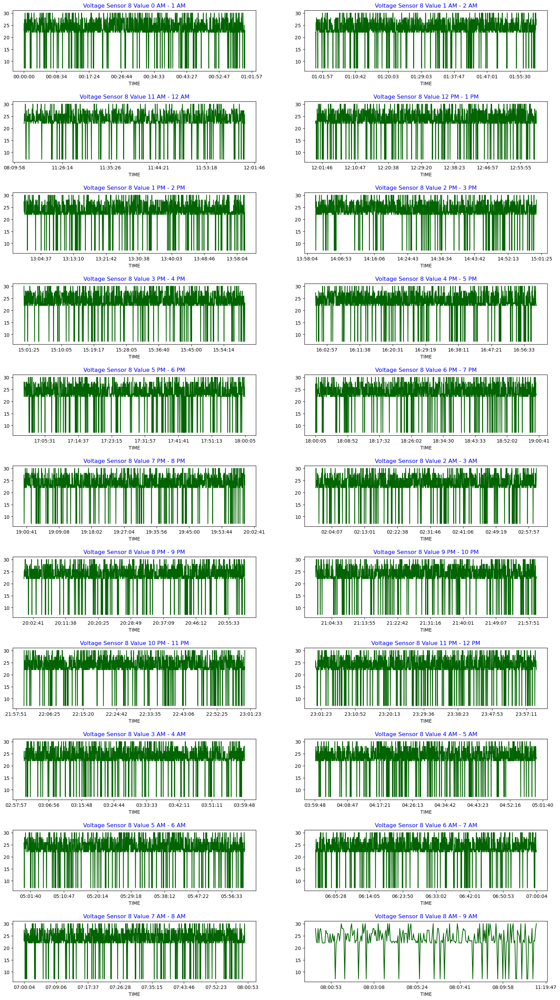

In [31]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_8']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 8 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


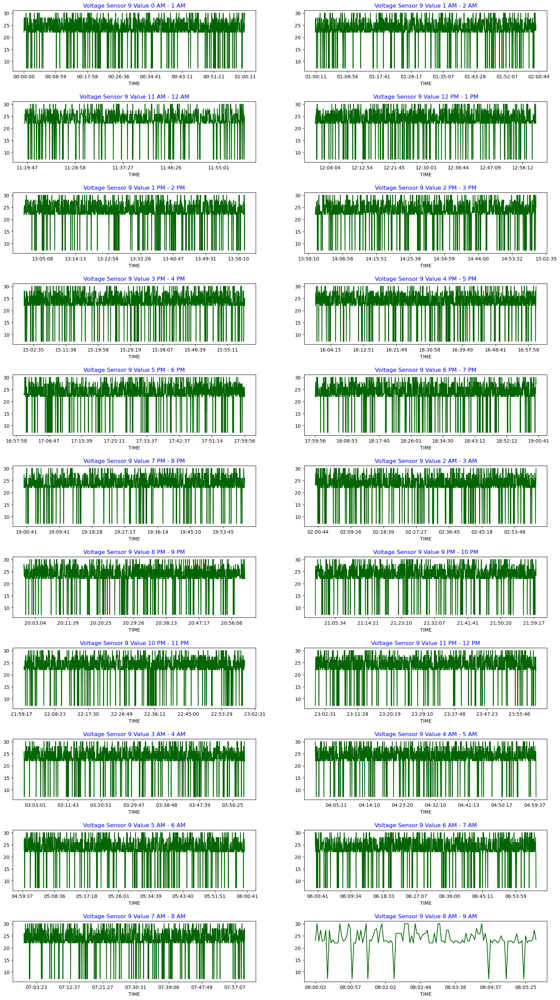

In [32]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_9']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 9 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


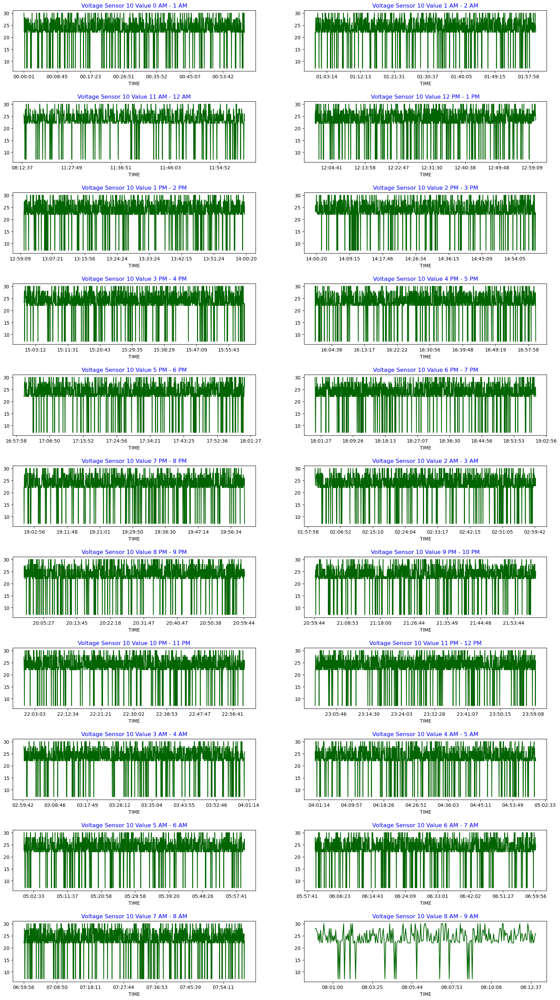

In [33]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_10']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 10 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


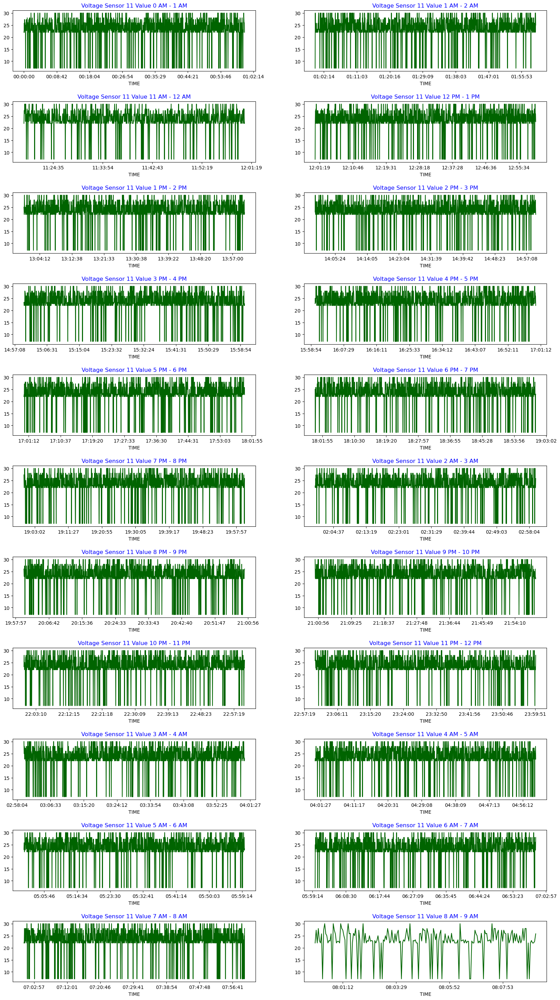

In [34]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_11']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 11 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


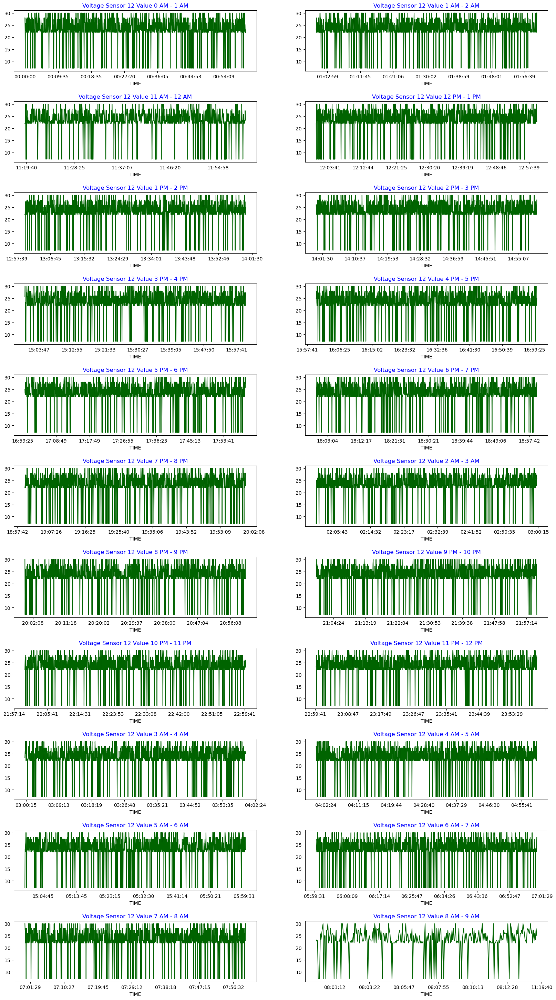

In [35]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_12']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 12 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


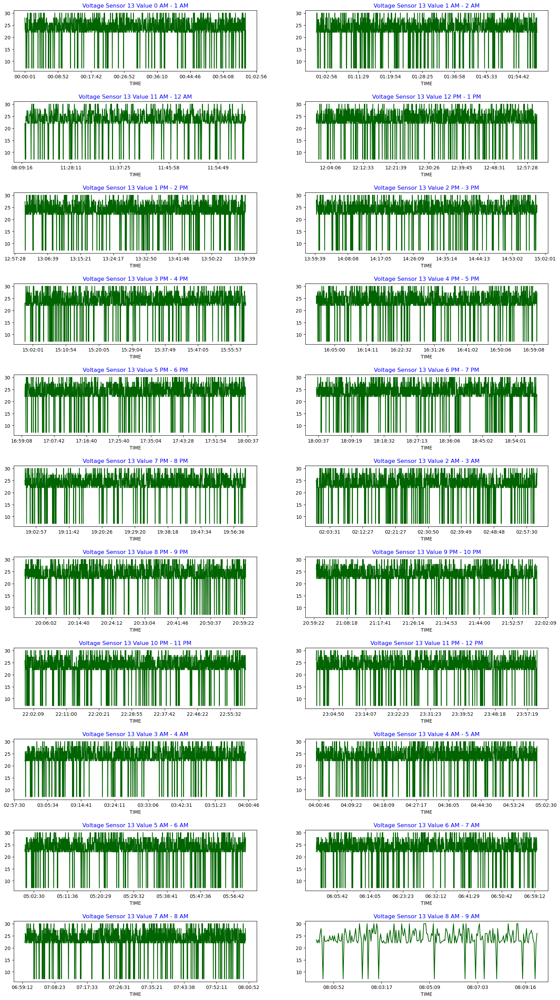

In [36]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_13']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 13 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


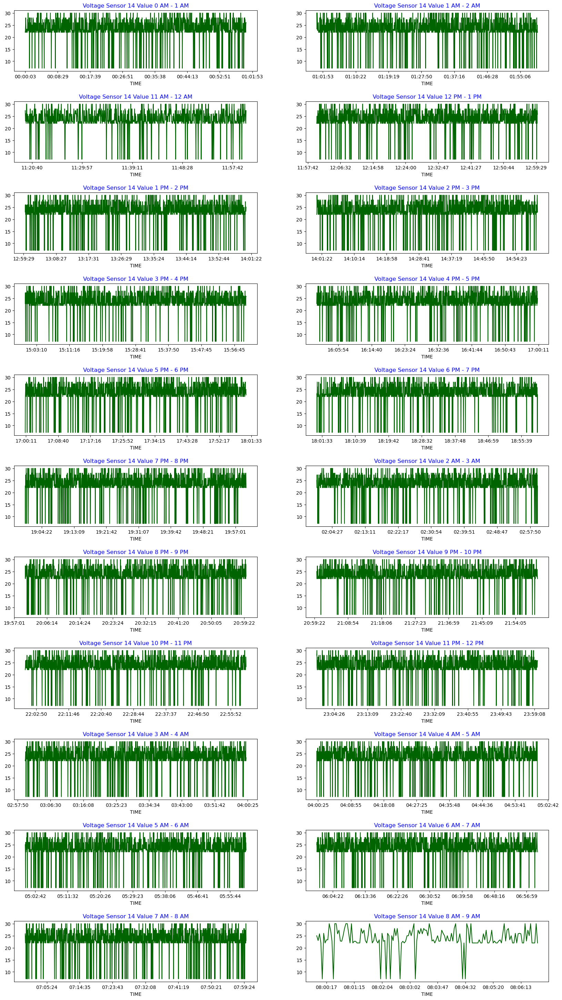

In [37]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_14']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 14 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


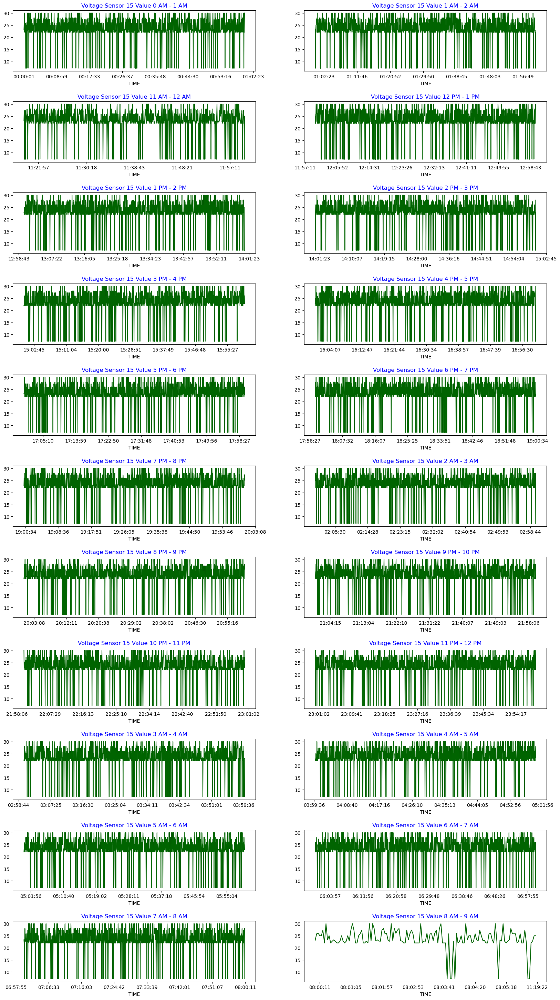

In [38]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_15']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 15 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


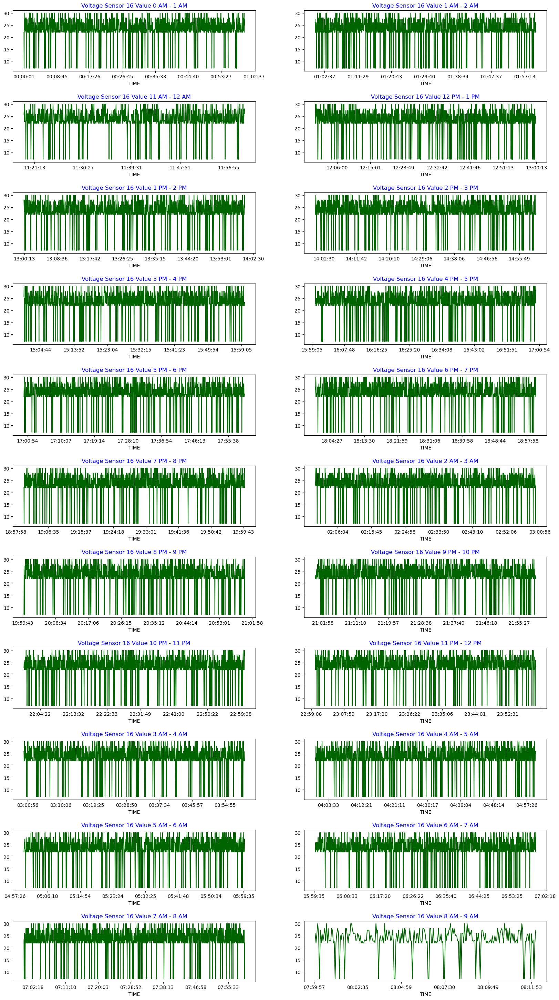

In [39]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_16']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 16 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


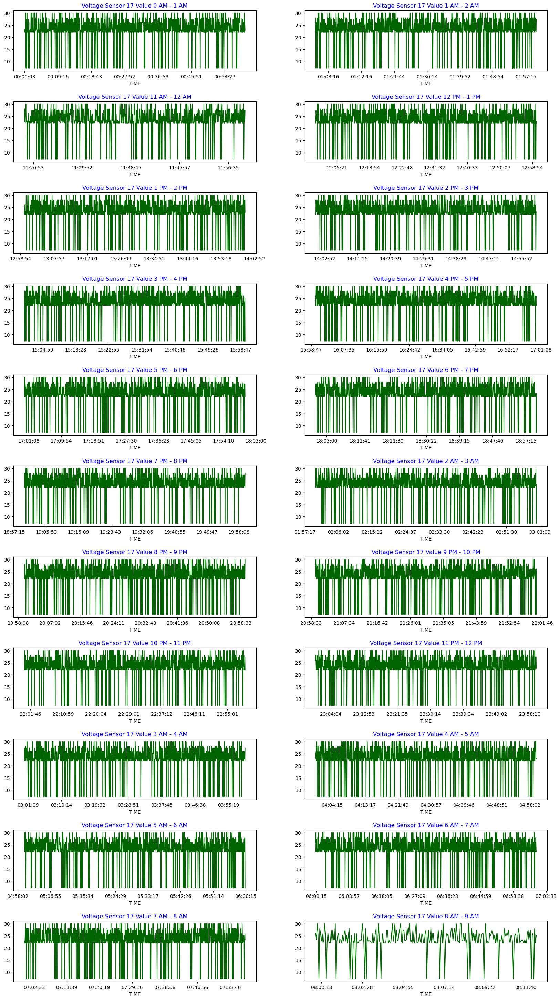

In [40]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_17']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 17 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


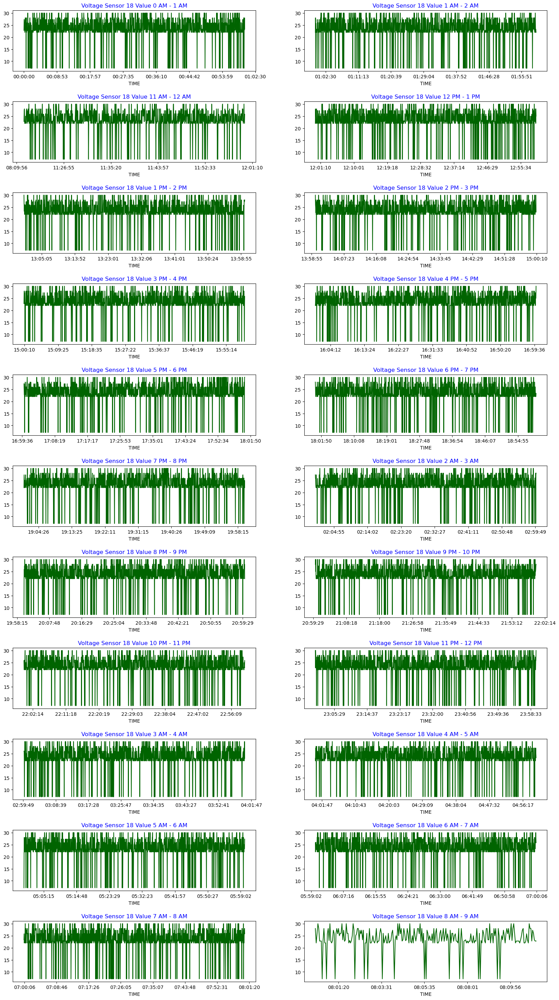

In [41]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_18']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 18 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


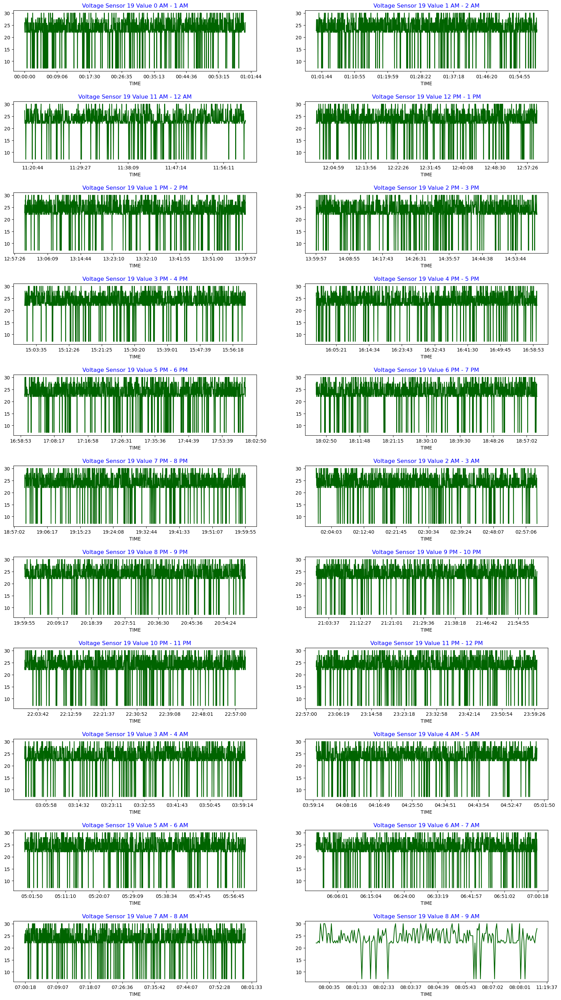

In [42]:
sensor_one_data = dataframe[dataframe['tid'] == 'voltage_sensor_19']

graph_data = sensor_one_data.pivot_table(values='sensor_values', index='TIME', columns='HOURS')

def Daywise_plot(data= None, row = None, col = None, title='Voltage Sensor 19 Value'):
    cols = data.columns # take all column
    gp = plt.figure(figsize=(20,40)) 
    
    gp.subplots_adjust(wspace=0.2, hspace=0.5)
    for i in range(1, len(cols)+1):
        ax = gp.add_subplot(row,col, i)
        data[cols[i-1]].plot(ax=ax, color='darkgreen')
        if int(cols[i-1]) < 12:
            if cols[i-1] == 0:
                ax.set_title('{} {} AM - {} AM'.format(title, int(cols[i-1]) + 12, int(cols[i-1]) + 1),color='blue')
            else:
                ax.set_title('{} {} AM - {} AM'.format(title, cols[i-1], int(cols[i-1]) + 1),color='blue')
                
        else:
            if int(cols[i-1]) == 12:
                ax.set_title('{} {} PM - {} PM'.format(title, cols[i-1], int(cols[i-1]) - 11),color='blue')
            else:
                ax.set_title('{} {} PM - {} PM'.format(title, int(cols[i-1]) - 12, int(cols[i-1]) - 11),color='blue')
                
            
Daywise_plot(data=graph_data, row=12, col=2)
        


### Observations:

 - All sensors have values greater than the mean (approximately 23) for 90% of the time in the day
 - There are intermittent fluctuations in all voltage sensors, where the voltage suddenly drops to the minimum value (approximately 7) and rises above the average again very quickly
 - All voltage sensors have similarly shaped graphs for all times in the day except between 8 AM and 9 AM. During this period, there is a wide variation in voltage fluctuation across sensors.

## Q.4 What is the mean value for each sensor tid alongwith the spread (standard deviation)

In [43]:
cent_disp = {'id': [],'mean': [], 'std': []}

for index in range(20):`
    iterator = 'voltage_sensor_' + str(index)`
    disp_data = dataframe[dataframe['tid'] == iterator]
    cent_disp['id'].append(iterator)
    cent_disp['mean'].append(disp_data['sensor_values'].mean())
    cent_disp['std'].append(disp_data['sensor_values'].std())
    
disp_data = pd.DataFrame(cent_disp)
disp_data

,id,mean,std
0,voltage_sensor_0,23.383766,5.111436
1,voltage_sensor_1,23.351686,5.126789
2,voltage_sensor_2,23.348754,5.144554
3,voltage_sensor_3,23.348239,5.177981
4,voltage_sensor_4,23.397164,5.067359
5,voltage_sensor_5,23.326377,5.161164
6,voltage_sensor_6,23.361431,5.122499
7,voltage_sensor_7,23.371343,5.097777
8,voltage_sensor_8,23.357130,5.109531
9,voltage_sensor_9,23.335806,5.103443


## Q.5 Peak voltage times for each sensor tid

In [44]:
iterator = 'voltage_sensor_' + str(1)
peak_df = dataframe[dataframe['tid'] == iterator]
# cent_disp['id'].append(iterator)
# peak_data['peak_voltage'].append(peak_df['sensor_values'].max())
peak_df.loc[peak_df['sensor_values'] == peak_df['sensor_values'].max()]['timestamps'].values

array(['2022-05-06T11:19:23.000000000', '2022-05-06T11:21:20.000000000',
       '2022-05-06T11:21:38.000000000', ...,
       '2022-05-07T08:04:37.000000000', '2022-05-07T08:05:43.000000000',
       '2022-05-07T08:06:38.000000000'], dtype='datetime64[ns]')

In [46]:
peak_data = {'id': [],'peak_voltage': [], 'time': []}

for index in range(20):
    iterator = 'voltage_sensor_' + str(index)
    peak_df = dataframe[dataframe['tid'] == iterator]
    if len(peak_df.loc[peak_df['sensor_values'] == peak_df['sensor_values'].max()]['timestamps']) > 1:
        list_times = []
        peak_data['id'].append(iterator)
        peak_data['peak_voltage'].append(peak_df['sensor_values'].max())   
        for value in peak_df.loc[peak_df['sensor_values'] == peak_df['sensor_values'].max()]['timestamps'].values:
            list_times.append(str(value))
            
        peak_data['time'].append(list_times)
            
peak_data_combined = pd.DataFrame(peak_data)
peak_data_combined

,id,peak_voltage,time
0,voltage_sensor_0,30.0,"[2022-05-06T11:19:40.000000000, 2022-05-06T11:..."
1,voltage_sensor_1,30.0,"[2022-05-06T11:19:23.000000000, 2022-05-06T11:..."
2,voltage_sensor_2,30.0,"[2022-05-06T11:19:28.000000000, 2022-05-06T11:..."
3,voltage_sensor_3,30.0,"[2022-05-06T11:21:32.000000000, 2022-05-06T11:..."
4,voltage_sensor_4,30.0,"[2022-05-06T11:19:32.000000000, 2022-05-06T11:..."
5,voltage_sensor_5,30.0,"[2022-05-06T11:20:41.000000000, 2022-05-06T11:..."
6,voltage_sensor_6,30.0,"[2022-05-06T11:19:50.000000000, 2022-05-06T11:..."
7,voltage_sensor_7,30.0,"[2022-05-06T11:21:53.000000000, 2022-05-06T11:..."
8,voltage_sensor_8,30.0,"[2022-05-06T11:19:36.000000000, 2022-05-06T11:..."
9,voltage_sensor_9,30.0,"[2022-05-06T11:20:26.000000000, 2022-05-06T11:..."


## Q.6 Low voltage times for each sensor tid

In [47]:
low_data = {'id': [],'lowest_voltage': [], 'time': []}

for index in range(20):
    iterator = 'voltage_sensor_' + str(index)
    low_df = dataframe[dataframe['tid'] == iterator]
    if len(low_df.loc[low_df['sensor_values'] == low_df['sensor_values'].min()]['timestamps']) > 1:
        list_times = []
        low_data['id'].append(iterator)
        low_data['lowest_voltage'].append(low_df['sensor_values'].min())   
        for value in low_df.loc[low_df['sensor_values'] == low_df['sensor_values'].min()]['timestamps'].values:
            list_times.append(str(value))
            
        low_data['time'].append(list_times)
            
low_data_combined = pd.DataFrame(low_data)
low_data_combined

,id,lowest_voltage,time
0,voltage_sensor_0,7.1,"[2022-05-06T11:20:17.000000000, 2022-05-06T11:..."
1,voltage_sensor_1,7.1,"[2022-05-06T11:19:22.000000000, 2022-05-06T11:..."
2,voltage_sensor_2,7.1,"[2022-05-06T11:19:44.000000000, 2022-05-06T11:..."
3,voltage_sensor_3,7.1,"[2022-05-06T11:19:20.000000000, 2022-05-06T11:..."
4,voltage_sensor_4,7.1,"[2022-05-06T11:20:35.000000000, 2022-05-06T11:..."
5,voltage_sensor_5,7.1,"[2022-05-06T11:19:34.000000000, 2022-05-06T11:..."
6,voltage_sensor_6,7.1,"[2022-05-06T11:20:01.000000000, 2022-05-06T11:..."
7,voltage_sensor_7,7.1,"[2022-05-06T11:19:53.000000000, 2022-05-06T11:..."
8,voltage_sensor_8,7.1,"[2022-05-06T11:19:40.000000000, 2022-05-06T11:..."
9,voltage_sensor_9,7.1,"[2022-05-06T11:19:59.000000000, 2022-05-06T11:..."


## Q.7 How many potential anomalies were found? Describe your thought process

Analyzing and detecting anomalies requires a minute-by-minute analysis of each sensor's data, which is a time consuming and arduous process if done manually. A more efficient way to detect anomalies would be using supervised and unsupervised machine learning methods, some of which are listed below:

**Supervised Techniques**:

* Classification Models: Train a classification model (like Random Forest, SVM, or Neural Networks) on labeled data where anomalies are already marked. Predict anomalies based on the learned patterns.
* One-Class SVM: Train a one-class SVM on normal voltage data. Anomalies are identified as points that fall outside the learned support of the model.
* Isolation Forest: This algorithm isolates anomalies by randomly selecting a feature and then isolating it by randomly selecting a split value between the maximum and minimum values of the selected feature.
* Autoencoders: Use neural networks for learning the data distribution in an unsupervised manner. The reconstruction error can help identify anomalies.

**Unsupervised Techniques**:

* Local Outlier Factor (LOF): Computes the local density deviation of a given data point with respect to its neighbors. Anomalies have lower density than their neighbors.
* DBSCAN (Density-Based Spatial Clustering of Applications with Noise): A clustering algorithm that groups together points that are closely packed together, marking as outliers points that lie alone in low-density regions.

